In [1]:
# This Python 3 environment comes with many helpful analytics libraries installed
# It is defined by the kaggle/python Docker image: https://github.com/kaggle/docker-python
# For example, here's several helpful packages to load

import numpy as np # linear algebra
import pandas as pd # data processing, CSV file I/O (e.g. pd.read_csv)

# Input data files are available in the read-only "../input/" directory
# For example, running this (by clicking run or pressing Shift+Enter) will list all files under the input directory

import os
for dirname, _, filenames in os.walk('/kaggle/input'):
    for filename in filenames:
        print(os.path.join(dirname, filename))

# You can write up to 20GB to the current directory (/kaggle/working/) that gets preserved as output when you create a version using "Save & Run All" 
# You can also write temporary files to /kaggle/temp/, but they won't be saved outside of the current session

/kaggle/input/cryoet-monai-requirements/gunicorn-20.1.0-py3-none-any.whl
/kaggle/input/cryoet-monai-requirements/pyasn1-0.6.1-py3-none-any.whl
/kaggle/input/cryoet-monai-requirements/docker-7.1.0-py3-none-any.whl
/kaggle/input/cryoet-monai-requirements/graphene-3.4.3-py2.py3-none-any.whl
/kaggle/input/cryoet-monai-requirements/urllib3-2.3.0-py3-none-any.whl
/kaggle/input/cryoet-monai-requirements/opentelemetry_semantic_conventions-0.50b0-py3-none-any.whl
/kaggle/input/cryoet-monai-requirements/tzdata-2025.1-py2.py3-none-any.whl
/kaggle/input/cryoet-monai-requirements/fsspec-2024.12.0-py3-none-any.whl
/kaggle/input/cryoet-monai-requirements/filelock-3.17.0-py3-none-any.whl
/kaggle/input/cryoet-monai-requirements/certifi-2024.12.14-py3-none-any.whl
/kaggle/input/cryoet-monai-requirements/smmap-5.0.2-py3-none-any.whl
/kaggle/input/cryoet-monai-requirements/alembic-1.14.1-py3-none-any.whl
/kaggle/input/cryoet-monai-requirements/click-8.1.8-py3-none-any.whl
/kaggle/input/cryoet-monai-requir

## Setup Instructions
Before running this notebook, please ensure you have added the dataset `cryoet-monai-requirements` and `copick` as input. Here's how:

1. Click on **Add Input** on the right side panel.
2. Search for `cryto`under **Competition Datasets** `cryoet-monai-requirements`,`copick` under **Datasets** and `model_60.pth`under **Models**.
3. Click the **+** to add it to your notebook.

Once added, the following cell will install the necessary packages:

In [2]:
!pip install --no-index --find-links=/kaggle/input/cryoet-monai-requirements -r /kaggle/input/cryoet-monai-requirements/requirements.txt
!pip install --no-deps --no-index --find-links=/kaggle/input/copick-utils/dependencies -r /kaggle/input/copick-utils/requirements.txt

Looking in links: /kaggle/input/cryoet-monai-requirements
Processing /kaggle/input/cryoet-monai-requirements/monai_weekly-1.5.dev2502-py3-none-any.whl (from -r /kaggle/input/cryoet-monai-requirements/requirements.txt (line 1))
Processing /kaggle/input/cryoet-monai-requirements/mlflow-2.19.0-py3-none-any.whl (from -r /kaggle/input/cryoet-monai-requirements/requirements.txt (line 5))
Processing /kaggle/input/cryoet-monai-requirements/mlflow_skinny-2.19.0-py3-none-any.whl (from mlflow==2.19.0->-r /kaggle/input/cryoet-monai-requirements/requirements.txt (line 5))
Processing /kaggle/input/cryoet-monai-requirements/graphene-3.4.3-py2.py3-none-any.whl (from mlflow==2.19.0->-r /kaggle/input/cryoet-monai-requirements/requirements.txt (line 5))
Processing /kaggle/input/cryoet-monai-requirements/gunicorn-20.1.0-py3-none-any.whl (from mlflow==2.19.0->-r /kaggle/input/cryoet-monai-requirements/requirements.txt (line 5))
Processing /kaggle/input/cryoet-monai-requirements/databricks_sdk-0.41.0-py3-no

In [3]:
# !ls /kaggle/input/

In [3]:
import monai
print(monai.__version__)

1.5.dev2502


In [4]:
# Make a copick project
import os
import shutil

config_blob = """{
    "name": "czii_cryoet_mlchallenge_2024",
    "description": "2024 CZII CryoET ML Challenge training data.",
    "version": "1.0.0",

    "pickable_objects": [
        {
            "name": "apo-ferritin",
            "is_particle": true,
            "pdb_id": "4V1W",
            "label": 1,
            "color": [  0, 117, 220, 128],
            "radius": 60,
            "map_threshold": 0.0418
        },
        {
            "name": "beta-galactosidase",
            "is_particle": true,
            "pdb_id": "6X1Q",
            "label": 3,
            "color": [ 76,   0,  92, 128],
            "radius": 90,
            "map_threshold": 0.0578
        },
        {
            "name": "ribosome",
            "is_particle": true,
            "pdb_id": "6EK0",
            "label": 4,
            "color": [  0,  92,  49, 128],
            "radius": 150,
            "map_threshold": 0.0374
        },
        {
            "name": "thyroglobulin",
            "is_particle": true,
            "pdb_id": "6SCJ",
            "label": 5,
            "color": [ 43, 206,  72, 128],
            "radius": 130,
            "map_threshold": 0.0278
        },
        {
            "name": "virus-like-particle",
            "is_particle": true,
            "label": 6,
            "color": [255, 204, 153, 128],
            "radius": 135,
            "map_threshold": 0.201
        },
        {
            "name": "membrane",
            "is_particle": false,
            "label": 8,
            "color": [100, 100, 100, 128]
        },
        {
            "name": "background",
            "is_particle": false,
            "label": 9,
            "color": [10, 150, 200, 128]
        }
    ],

    "overlay_root": "/kaggle/working/overlay",

    "overlay_fs_args": {
        "auto_mkdir": true
    },

    "static_root": "/kaggle/input/czii-cryo-et-object-identification/train/static"
}"""

copick_config_path = "/kaggle/working/copick.config"
output_overlay = "/kaggle/working/overlay"

with open(copick_config_path, "w") as f:
    f.write(config_blob)
    
# Update the overlay
# Define source and destination directories
source_dir = '/kaggle/input/czii-cryo-et-object-identification/train/overlay'
destination_dir = '/kaggle/working/overlay'

# Walk through the source directory
for root, dirs, files in os.walk(source_dir):
    # Create corresponding subdirectories in the destination
    relative_path = os.path.relpath(root, source_dir)
    target_dir = os.path.join(destination_dir, relative_path)
    os.makedirs(target_dir, exist_ok=True)
    
    # Copy and rename each file
    for file in files:
        if file.startswith("curation_0_"):
            new_filename = file
        else:
            new_filename = f"curation_0_{file}"
            
        
        # Define full paths for the source and destination files
        source_file = os.path.join(root, file)
        destination_file = os.path.join(target_dir, new_filename)
        
        # Copy the file with the new name
        shutil.copy2(source_file, destination_file)
        print(f"Copied {source_file} to {destination_file}")

Copied /kaggle/input/czii-cryo-et-object-identification/train/overlay/ExperimentRuns/TS_86_3/Picks/beta-amylase.json to /kaggle/working/overlay/ExperimentRuns/TS_86_3/Picks/curation_0_beta-amylase.json
Copied /kaggle/input/czii-cryo-et-object-identification/train/overlay/ExperimentRuns/TS_86_3/Picks/beta-galactosidase.json to /kaggle/working/overlay/ExperimentRuns/TS_86_3/Picks/curation_0_beta-galactosidase.json
Copied /kaggle/input/czii-cryo-et-object-identification/train/overlay/ExperimentRuns/TS_86_3/Picks/apo-ferritin.json to /kaggle/working/overlay/ExperimentRuns/TS_86_3/Picks/curation_0_apo-ferritin.json
Copied /kaggle/input/czii-cryo-et-object-identification/train/overlay/ExperimentRuns/TS_86_3/Picks/virus-like-particle.json to /kaggle/working/overlay/ExperimentRuns/TS_86_3/Picks/curation_0_virus-like-particle.json
Copied /kaggle/input/czii-cryo-et-object-identification/train/overlay/ExperimentRuns/TS_86_3/Picks/ribosome.json to /kaggle/working/overlay/ExperimentRuns/TS_86_3/Pic

## Importing libraries

In [5]:
import os
import numpy as np
from pathlib import Path
import torch
import torchinfo
import zarr, copick
from tqdm import tqdm
from monai.data import DataLoader, Dataset, CacheDataset, decollate_batch
from monai.transforms import (
    Compose, 
    EnsureChannelFirstd, 
    Orientationd,  
    AsDiscrete,  
    RandFlipd, 
    RandRotate90d, 
    NormalizeIntensityd,
    RandCropByLabelClassesd,
)
from monai.networks.nets import UNet
from monai.losses import DiceLoss, FocalLoss, TverskyLoss
from monai.metrics import DiceMetric, ConfusionMatrixMetric
import mlflow
import mlflow.pytorch

Prepare the Dataset

## 1. Get the copick root

In [6]:
import copick

root = copick.from_file(copick_config_path)

copick_user_name = "copickUtils"
copick_segmentation_name = "paintedPicks"
voxel_size = 10
tomo_type = "denoised"

## 2. Generate multi-class segmentation masks from picks, and saved them to the copick overlay directory (one-time)

In [7]:
from copick_utils.segmentation import segmentation_from_picks
import copick_utils.writers.write as write
from collections import defaultdict
import numpy as np
from tqdm import tqdm

# Just do this once
generate_masks = True

if generate_masks:
    target_objects = defaultdict(dict)
    for object in root.pickable_objects:
        if object.is_particle:
            target_objects[object.name]['label'] = object.label
            target_objects[object.name]['radius'] = object.radius

    for run in tqdm(root.runs, desc="Generating masks per run"):
        # Use get_tomograms instead of get_tomogram
        tomograms = run.get_voxel_spacing(10).get_tomograms(tomo_type)
        if not tomograms:
            print(f"No tomograms found for run {run.name}")
            continue
        tomo = tomograms[0].numpy()  # Assuming we take the first tomogram if multiple are available
        print(f"Tomogram shape: {tomo.shape}")  # Debug: Print tomogram shape
        
        target = np.zeros(tomo.shape, dtype=np.uint8)
        print(f"Initial target shape: {target.shape}, dtype: {target.dtype}") # Debug: Print initial target shape and dtype
        
        for pickable_object in root.pickable_objects:
            if pickable_object.is_particle:  # Only deal with particle objects
                picks = run.get_picks(object_name=pickable_object.name, user_id="curation")
                if picks:  # Check if there are any picks for this object
                    radius = target_objects[pickable_object.name]['radius'] * 0.8
                    label = target_objects[pickable_object.name]['label']
                    
                    # Assuming segmentation_from_picks has a method 'from_picks'
                    target = segmentation_from_picks.from_picks(picks[0], target, radius, label)
        
        # Writing the segmentation
        write.segmentation(run, target, copick_user_name, name=copick_segmentation_name)

Generating masks per run:   0%|          | 0/7 [00:00<?, ?it/s]

Tomogram shape: (184, 630, 630)
Initial target shape: (184, 630, 630), dtype: uint8


Generating masks per run:  14%|█▍        | 1/7 [00:03<00:23,  3.99s/it]

Tomogram shape: (184, 630, 630)
Initial target shape: (184, 630, 630), dtype: uint8


Generating masks per run:  29%|██▊       | 2/7 [00:06<00:15,  3.09s/it]

Tomogram shape: (184, 630, 630)
Initial target shape: (184, 630, 630), dtype: uint8


Generating masks per run:  43%|████▎     | 3/7 [00:08<00:11,  2.77s/it]

Tomogram shape: (184, 630, 630)
Initial target shape: (184, 630, 630), dtype: uint8


Generating masks per run:  57%|█████▋    | 4/7 [00:11<00:07,  2.59s/it]

Tomogram shape: (184, 630, 630)
Initial target shape: (184, 630, 630), dtype: uint8


Generating masks per run:  71%|███████▏  | 5/7 [00:13<00:04,  2.49s/it]

Tomogram shape: (184, 630, 630)
Initial target shape: (184, 630, 630), dtype: uint8


Generating masks per run:  86%|████████▌ | 6/7 [00:15<00:02,  2.48s/it]

Tomogram shape: (184, 630, 630)
Initial target shape: (184, 630, 630), dtype: uint8


Generating masks per run: 100%|██████████| 7/7 [00:18<00:00,  2.62s/it]


## 3. Get tomograms and their segmentaion masks (from picks) arrays

In [8]:
from tqdm import tqdm
import numpy as np

# --- Data Loading ---
data_dicts = []
for run in tqdm(root.runs):
    tomograms = run.get_voxel_spacing(voxel_size).get_tomograms(tomo_type)
    if not tomograms:
        print(f"No tomograms found for run {run.name}")
        continue

    tomogram = tomograms[0].numpy()
    print(f"Tomogram shape for {run.name}: {tomogram.shape}")

    try:
        segmentations = run.get_segmentations(name=copick_segmentation_name, user_id=copick_user_name, voxel_size=voxel_size, is_multilabel=True)
        if not segmentations:
            print(f"No segmentations found for {run.name}")
            continue
        segmentation = segmentations[0].numpy()

        # Check if segmentation is all zeros
        if np.all(segmentation == 0):
            print(f"Segmentation for {run.name} is all zeros.")
        else:
            print(f"Segmentation for {run.name} has values: {np.unique(segmentation)}")

        data_dicts.append({"image": tomogram, "label": segmentation})
    except AttributeError:
        print(f"Method get_segmentations not available for run {run.name}")
    except IndexError:
        print(f"No segmentation data found for {run.name}")
    except Exception as e:
        print(f"Unexpected error getting segmentation for {run.name}: {e}")

if data_dicts:
    print(f"Unique labels in the first segmentation: {np.unique(data_dicts[0]['label'])}")
else:
    print("No data collected from runs.")

  0%|          | 0/7 [00:00<?, ?it/s]

Tomogram shape for TS_5_4: (184, 630, 630)


 14%|█▍        | 1/7 [00:04<00:28,  4.77s/it]

Segmentation for TS_5_4 has values: [0 1 3 4 5 6]
Tomogram shape for TS_69_2: (184, 630, 630)


 29%|██▊       | 2/7 [00:09<00:24,  4.90s/it]

Segmentation for TS_69_2 has values: [0 1 3 4 5 6]
Tomogram shape for TS_6_4: (184, 630, 630)


 43%|████▎     | 3/7 [00:17<00:23,  6.00s/it]

Segmentation for TS_6_4 has values: [0 1 3 4 5 6]
Tomogram shape for TS_6_6: (184, 630, 630)


 57%|█████▋    | 4/7 [00:21<00:16,  5.56s/it]

Segmentation for TS_6_6 has values: [0 1 3 4 5 6]
Tomogram shape for TS_73_6: (184, 630, 630)


 71%|███████▏  | 5/7 [00:25<00:09,  4.67s/it]

Segmentation for TS_73_6 has values: [0 1 3 4 5 6]
Tomogram shape for TS_86_3: (184, 630, 630)


 86%|████████▌ | 6/7 [00:28<00:04,  4.11s/it]

Segmentation for TS_86_3 has values: [0 1 3 4 5 6]
Tomogram shape for TS_99_9: (184, 630, 630)


100%|██████████| 7/7 [00:31<00:00,  4.45s/it]

Segmentation for TS_99_9 has values: [0 1 3 4 5 6]


Unique labels in the first segmentation: [0 1 3 4 5 6]


Processing Runs:   0%|          | 0/7 [00:00<?, ?run/s]

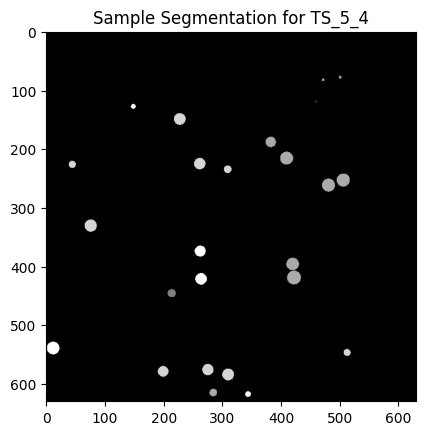

Processing Runs:  14%|█▍        | 1/7 [00:01<00:08,  1.50s/run]

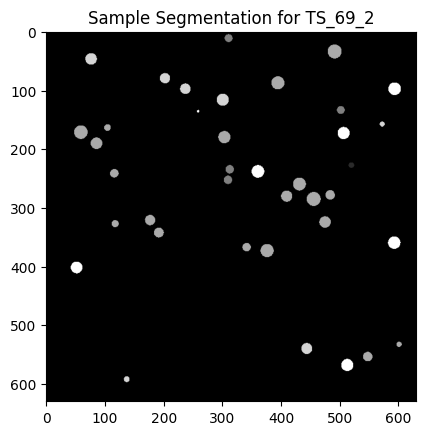

Processing Runs:  29%|██▊       | 2/7 [00:02<00:06,  1.38s/run]

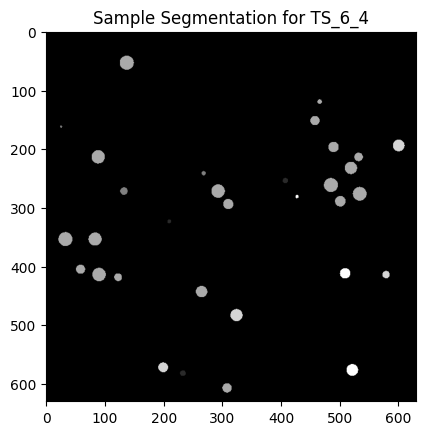

Processing Runs:  43%|████▎     | 3/7 [00:04<00:05,  1.38s/run]

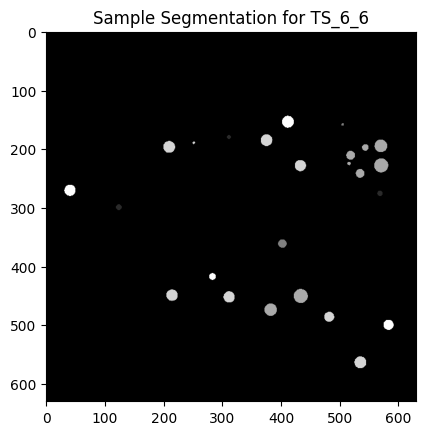

Processing Runs:  57%|█████▋    | 4/7 [00:05<00:03,  1.32s/run]

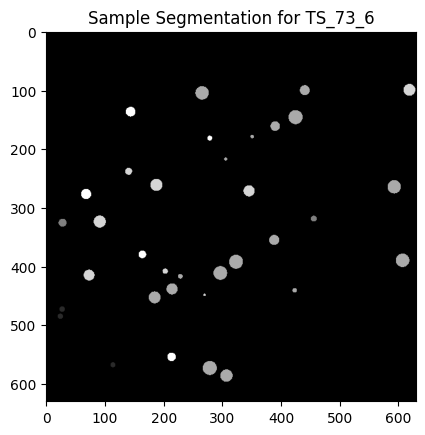

Processing Runs:  71%|███████▏  | 5/7 [00:06<00:02,  1.27s/run]

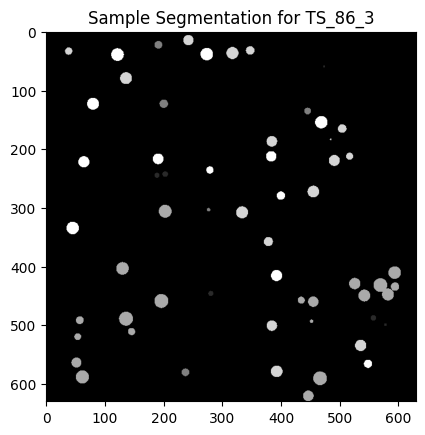

Processing Runs:  86%|████████▌ | 6/7 [00:07<00:01,  1.23s/run]

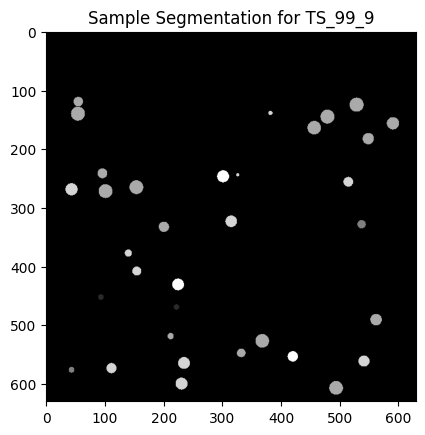

Processing Runs: 100%|██████████| 7/7 [00:09<00:00,  1.29s/run]


In [9]:
from tqdm import tqdm
import numpy as np
import logging
import matplotlib.pyplot as plt

# Configure logging
logging.basicConfig(level=logging.INFO, format="%(asctime)s - %(message)s")

# --- Data Loading ---
data_dicts = []

for run in tqdm(root.runs, desc="Processing Runs", unit="run"):
    try:
        tomograms = run.get_voxel_spacing(voxel_size).get_tomograms(tomo_type)
        if not tomograms:
            logging.warning(f"No tomograms found for run {run.name}")
            continue

        tomogram = tomograms[0].numpy()
        logging.info(f"Tomogram shape for {run.name}: {tomogram.shape}")

        segmentations = run.get_segmentations(
            name=copick_segmentation_name, user_id=copick_user_name,
            voxel_size=voxel_size, is_multilabel=True
        )
        if not segmentations:
            logging.warning(f"No segmentations found for {run.name}")
            continue

        segmentation = segmentations[0].numpy()
        if np.all(segmentation == 0):
            logging.warning(f"Segmentation for {run.name} is all zeros.")
            continue

        if segmentation.shape != tomogram.shape:
            logging.warning(f"Shape mismatch for {run.name}: "
                            f"tomogram {tomogram.shape}, segmentation {segmentation.shape}")
            continue

        # Optionally visualize
        plt.imshow(segmentation[segmentation.shape[0] // 2], cmap="gray")
        plt.title(f"Sample Segmentation for {run.name}")
        plt.show()

        data_dicts.append({"image": tomogram, "label": segmentation})
    except Exception as e:
        logging.error(f"Error processing run {run.name}: {e}")

if data_dicts:
    logging.info(f"Unique labels in the first segmentation: {np.unique(data_dicts[0]['label'])}")
else:
    logging.warning("No data collected from runs.")

In [10]:
for run in root.runs:
    for pickable_object in root.pickable_objects:
        if pickable_object.is_particle:
            picks = run.get_picks(object_name=pickable_object.name, user_id="curation")
            print(f"Run: {run.name}, Object: {pickable_object.name}, Number of picks: {len(picks)}")

Run: TS_5_4, Object: apo-ferritin, Number of picks: 1
Run: TS_5_4, Object: beta-galactosidase, Number of picks: 1
Run: TS_5_4, Object: ribosome, Number of picks: 1
Run: TS_5_4, Object: thyroglobulin, Number of picks: 1
Run: TS_5_4, Object: virus-like-particle, Number of picks: 1
Run: TS_69_2, Object: apo-ferritin, Number of picks: 1
Run: TS_69_2, Object: beta-galactosidase, Number of picks: 1
Run: TS_69_2, Object: ribosome, Number of picks: 1
Run: TS_69_2, Object: thyroglobulin, Number of picks: 1
Run: TS_69_2, Object: virus-like-particle, Number of picks: 1
Run: TS_6_4, Object: apo-ferritin, Number of picks: 1
Run: TS_6_4, Object: beta-galactosidase, Number of picks: 1
Run: TS_6_4, Object: ribosome, Number of picks: 1
Run: TS_6_4, Object: thyroglobulin, Number of picks: 1
Run: TS_6_4, Object: virus-like-particle, Number of picks: 1
Run: TS_6_6, Object: apo-ferritin, Number of picks: 1
Run: TS_6_6, Object: beta-galactosidase, Number of picks: 1
Run: TS_6_6, Object: ribosome, Number of 

## 4. Visualize the tomogram and painted segmentation from ground-truth picks

In [11]:
import matplotlib.pyplot as plt
from matplotlib.animation import FuncAnimation
from IPython.display import HTML

# Extract images and labels from data_dicts
images = data_dicts[0]['image']
labels = data_dicts[0]['label']

# Validate data shapes
assert images.shape[0] == labels.shape[0], "Mismatch in number of slices between images and labels!"

# Create a figure for animation
fig, axes = plt.subplots(1, 2, figsize=(15, 5))

# Set up subplots
ax1, ax2 = axes
im1 = ax1.imshow(images[0], cmap='gray', interpolation='none')
ax1.set_title("Tomogram")
ax1.axis('off')

im2 = ax2.imshow(labels[0], cmap='viridis', interpolation='none')
ax2.set_title("Painted Segmentation from Picks")
ax2.axis('off')

# Add colorbars
fig.colorbar(im1, ax=ax1, orientation='vertical', label='Intensity')
fig.colorbar(im2, ax=ax2, orientation='vertical', label='Segmentation Labels')

# Update function for animation
def update(frame):
    im1.set_data(images[frame])
    im2.set_data(labels[frame])
    return [im1, im2]

# Sample every nth frame (optional)
n = 5
frames_to_display = range(0, len(images), n)

# Create the animation
ani = FuncAnimation(
    fig, update, frames=frames_to_display, interval=1000
)

# Display the animation
plt.close(fig)
HTML(ani.to_jshtml())

## 5. Prepare dataloaders

In [69]:
import os
import numpy as np

total_size = 0
for run in root.runs:
    tomograms = run.get_voxel_spacing(10).get_tomograms(tomo_type)
    if tomograms:  # Check if there are any tomograms
        tomo = tomograms[0].numpy()  # Use the first tomogram if multiple are returned
        total_size += tomo.nbytes  # Assuming tomo is now a numpy array for size calculation
    else:
        print(f"No tomograms found for run {run.name}")

print(f"Total size of tomograms: {total_size / (1024 * 1024):.2f} MB")

Total size of tomograms: 1950.10 MB


Total size of tomograms: 1950.10 MB

Total number of voxels in the dataset: 511207200

In [70]:
total_picks = 0
num_runs_with_picks = 0  # Counter for runs with picks

for run in root.runs:
    has_picks = False  # Flag to check if the current run has any picks
    for pickable_object in root.pickable_objects:
        if pickable_object.is_particle:
            picks = run.get_picks(object_name=pickable_object.name, user_id="curation")
            if picks:
                total_picks += len(picks)
                has_picks = True
    if has_picks:
        num_runs_with_picks += 1

print(f"Total number of picks: {total_picks}")
print(f"Number of runs with picks: {num_runs_with_picks}")

num_runs = len(root.runs)
print(f"Number of runs or tomograms in the dataset: {num_runs}")

total_voxels = 0
missing_tomograms = []  # List to store runs with missing tomograms

for run in root.runs:
    tomogram_list = run.get_voxel_spacing(10).get_tomograms(tomo_type)
    if tomogram_list:
        for tomogram in tomogram_list:
            tomo_numpy = tomogram.numpy()
            total_voxels += tomo_numpy.size
    else:
        missing_tomograms.append(run.name)
        print(f"No tomograms found for run {run.name}")

print(f"Total number of voxels in the dataset: {total_voxels}")

if missing_tomograms:
    print(f"Runs with missing tomograms: {', '.join(missing_tomograms)}")

Total number of picks: 35
Number of runs with picks: 7
Number of runs or tomograms in the dataset: 7
Total number of voxels in the dataset: 511207200


In [71]:
# Modularize Transforms
def get_non_random_transforms():
    return Compose([
        EnsureChannelFirstd(keys=["image", "label"], channel_dim="no_channel"),
        NormalizeIntensityd(keys="image"),
        Orientationd(keys=["image", "label"], axcodes="RAS")
    ])

def get_random_transforms(spatial_size, num_classes, num_samples):
    return Compose([
        RandCropByLabelClassesd(
            keys=["image", "label"],
            label_key="label",
            spatial_size=spatial_size,
            num_classes=num_classes,
            num_samples=num_samples
        ),
        RandRotate90d(keys=["image", "label"], prob=0.5, spatial_axes=[0, 2]),
        RandFlipd(keys=["image", "label"], prob=0.5, spatial_axis=0),
    ])

In [72]:
# Modularize Dataset Creation
def create_dataset(data_files, non_random_transforms, random_transforms, cache_rate=1.0):
    cached_ds = CacheDataset(data=data_files, transform=non_random_transforms, cache_rate=cache_rate)
    return Dataset(data=cached_ds, transform=random_transforms)

In [73]:
# Parameterize Dataset Splits
def split_dataset(data_dicts, train_ratio=0.7):
    split_index = int(len(data_dicts) * train_ratio)
    return data_dicts[:split_index], data_dicts[split_index:]

In [74]:
# Create a Utility for DataLoader
def create_dataloader(dataset, batch_size, shuffle, num_workers=4):
    return DataLoader(
        dataset,
        batch_size=batch_size,
        shuffle=shuffle,
        num_workers=num_workers,
        pin_memory=torch.cuda.is_available()
    )

In [75]:
import warnings
from monai.transforms import (
    Compose, EnsureChannelFirstd, NormalizeIntensityd, Orientationd, RandCropByLabelClassesd,
    RandRotate90d, RandFlipd
)
from monai.data import CacheDataset, Dataset, DataLoader
import torch

warnings.filterwarnings("ignore")

# Parameters
my_num_samples = 16
train_batch_size = 1
val_batch_size = 1
img_size = [96, 96, 96]
num_classes = len(root.pickable_objects) + 1  # +1 for background class

# Split dataset
train_files, val_files = split_dataset(data_dicts, train_ratio=0.7)
print(f"Number of training samples: {len(train_files)}")
print(f"Number of validation samples: {len(val_files)}")

# Transforms
non_random_transforms = get_non_random_transforms()
random_transforms = get_random_transforms(img_size, num_classes, my_num_samples)

# Create datasets
train_ds = create_dataset(train_files, non_random_transforms, random_transforms)
val_ds = create_dataset(val_files, non_random_transforms, random_transforms)

# Create DataLoaders
train_loader = create_dataloader(train_ds, train_batch_size, shuffle=True)
val_loader = create_dataloader(val_ds, val_batch_size, shuffle=False)

# Optional: Quick check of data shapes
for batch in train_loader:
    print("Training - Image shape:", batch["image"].shape)
    print("Training - Label shape:", batch["label"].shape)
    break

for batch in val_loader:
    print("Validation - Image shape:", batch["image"].shape)
    print("Validation - Label shape:", batch["label"].shape)
    break

Number of training samples: 4
Number of validation samples: 3


Loading dataset: 100%|██████████| 3/3 [00:01<00:00,  2.19it/s]


Training - Image shape: torch.Size([16, 1, 96, 96, 96])
Training - Label shape: torch.Size([16, 1, 96, 96, 96])
Validation - Image shape: torch.Size([16, 1, 96, 96, 96])
Validation - Label shape: torch.Size([16, 1, 96, 96, 96])


Size of Tensor of DataSets 
* Training - Image shape: torch.Size([16, 1, 96, 96, 96])
* Training - Label shape: torch.Size([16, 1, 96, 96, 96])
* Validation - Image shape: torch.Size([16, 1, 96, 96, 96])
* Validation - Label shape: torch.Size([16, 1, 96, 96, 96])

***This code is suppose to work***

## 6. Model setup

**ManualWeightedFocalLoss Module**

In [20]:
%%file loss.py

import torch
import torch.nn.functional as F

class ManualWeightedFocalLoss(nn.Module):
    def __init__(self, alpha=None, gamma=2, reduction='mean'):
        """
        alpha: Tensor of class weights (size: num_classes) or None for equal weighting.
        gamma: Focusing parameter for Focal Loss.
        reduction: Specifies the reduction to apply to the output ('none', 'mean', 'sum').
        """
        super(ManualWeightedFocalLoss, self).__init__()
        self.alpha = alpha if alpha is not None else None  # Tensor of weights for each class
        self.gamma = gamma
        self.reduction = reduction

    def forward(self, inputs, targets):
        """
        inputs: Predicted logits (shape: [batch_size, num_classes, depth, height, width]).
        targets: Ground truth labels (shape: [batch_size, depth, height, width]).
        """
        # If targets is a MONAI MetaTensor, extract the tensor part
        if hasattr(targets, 'tensor'):
            targets = targets.tensor  # Strip metadata
        
        # Ensure targets are integers (class indices)
        targets = targets.long()  # Convert targets to long type if necessary
        
        # Flatten the input tensors to match the expected shape for focal loss
        batch_size, num_channels, *spatial_dims = inputs.shape
        inputs = inputs.view(batch_size, num_channels, -1)  # Flatten spatial dimensions
        targets = targets.view(batch_size, -1)  # Flatten target to match

        # Convert targets to one-hot encoding
        targets_one_hot = F.one_hot(targets, num_classes=num_channels).permute(0, 2, 1).float()

        # Apply softmax to inputs to get probabilities
        probs = F.softmax(inputs, dim=1)
        
        # Gather probabilities corresponding to the true class
        probs_true_class = (probs * targets_one_hot).sum(dim=1)

        # Compute the focal loss factor
        focal_factor = (1 - probs_true_class) ** self.gamma

        # Compute log probabilities for the true class
        log_probs_true_class = torch.log(probs_true_class + 1e-8)

        # Compute raw focal loss
        raw_loss = -focal_factor * log_probs_true_class

        # Apply class weights (alpha) if provided
        if self.alpha is not None:
            if self.alpha.shape[0] != num_channels:
                raise ValueError(f"Alpha must have the same number of elements as the number of classes: {num_channels}")
            alpha_factor = self.alpha[targets]
            raw_loss = raw_loss * alpha_factor

        # Apply reduction
        if self.reduction == 'mean':
            return raw_loss.mean()
        elif self.reduction == 'sum':
            return raw_loss.sum()
        else:  # 'none'
            return raw_loss

Writing loss.py


**F4 Metric Module**

In [21]:
%%file metrics.py

# metrics.py
import torch
from monai.metrics import FBetaScore
from typing import List

class F4Score:
    def __init__(self, beta: int = 4, device: str = 'cuda'):
        """
        Initialize the F4Score class.

        :param beta: The beta value for the F-Score. Default is 4.
        :param device: The device to use for computations (e.g., 'cuda').
        """
        self.beta = beta
        self.device = device
        self.fbeta_score = FBetaScore(beta=beta, reduction="mean")  # MONAI metric

    def __call__(self, outputs: torch.Tensor, targets: torch.Tensor) -> float:
        """
        Compute the F4 score.

        :param outputs: The model outputs (logits) with shape [batch_size, num_classes].
        :param targets: The true labels (one-hot encoded) with shape [batch_size, num_classes].
        :return: The computed F4 score as a float.
        """
        # Ensure outputs and targets are on the correct device
        outputs = outputs.to(self.device)
        targets = targets.to(self.device)

        # Apply sigmoid to logits to obtain probabilities
        outputs = torch.sigmoid(outputs)

        # Decollate and process batch predictions and labels
        outputs_one_hot = [self.post_pred(i) for i in self.decollate_batch(outputs)]
        targets_one_hot = [self.post_label(i) for i in self.decollate_batch(targets)]

        # Convert processed lists back to tensors
        outputs_one_hot = torch.stack(outputs_one_hot).to(self.device)
        targets_one_hot = torch.stack(targets_one_hot).to(self.device)

        # Calculate the F4 score using the FBetaScore metric
        self.fbeta_score.reset()  # Reset metric state before calculation
        self.fbeta_score(y_pred=outputs_one_hot, y=targets_one_hot)

        # Aggregate the F4 score across the batch
        f4_mean = self.fbeta_score.aggregate()

        return f4_mean.item()

    def reset(self) -> None:
        """
        Reset the FBetaScore metric.
        """
        self.fbeta_score.reset()

    def post_pred(self, preds: torch.Tensor) -> torch.Tensor:
        """
        Post-process predictions (convert logits to one-hot encoding).

        :param preds: The model predictions as probabilities.
        :return: One-hot encoded predictions.
        """
        return (preds > 0.5).float()  # Threshold at 0.5

    def post_label(self, lbl: torch.Tensor) -> torch.Tensor:
        """
        Ensure labels are in one-hot encoding format.

        :param lbl: The ground truth labels.
        :return: One-hot encoded labels.
        """
        if lbl.ndim == 1:  # If labels are class indices
            num_classes = lbl.max().item() + 1
            return F.one_hot(lbl, num_classes=num_classes).float()
        return lbl.float()

    def decollate_batch(self, batch: torch.Tensor) -> List[torch.Tensor]:
        """
        Decollates the batch into individual examples.

        :param batch: The batch of data.
        :return: List of individual tensors.
        """
        if batch.ndim < 2:
            raise ValueError("Batch must have at least 2 dimensions (batch_size, ...)")
        return batch.unbind(0)

Writing metrics.py


**This model does work!**

### Update the pre-trained model ready for training!

In [32]:
import torch
from torch import nn
from torch.optim import AdamW
from monai.losses import TverskyLoss
from monai.metrics import DiceMetric, ConfusionMatrixMetric
from monai.networks.nets import UNet
from torchinfo import summary
import os
import torch.nn.functional as F
import warnings

# Suppress specific warnings
warnings.filterwarnings("ignore", message="no available indices of class 2 to crop")
warnings.filterwarnings("ignore", message="no available indices of class 7 to crop")

# --- Device ---
device = torch.device('cuda' if torch.cuda.is_available() else 'cpu')
print(f"Using device: {device}")

# --- Model ---
# Assuming 'root.pickable_objects' is defined elsewhere in the code
num_classes = len(root.pickable_objects) + 1  # +1 for background class
print(f"Number of classes (including background): {num_classes}")

model = UNet(
    spatial_dims=3,
    in_channels=1,  # This might need to be adjusted based on your input data
    out_channels=num_classes,
    channels=(48, 64, 80, 80),
    strides=(2, 2, 2),
    num_res_units=2,
).to(device)

# --- Load Pre-trained Weights ---
pretrained_weights_path = "/kaggle/input/model_60.pth/pytorch/ep/1/model_ep_60.pth"

if os.path.exists(pretrained_weights_path):
    print(f"Loading pre-trained weights from {pretrained_weights_path}...")
    try:
        # Load the pre-trained state_dict
        pretrained_state_dict = torch.load(pretrained_weights_path, map_location=device)
        
        # Load weights with strict=False to handle mismatched keys
        model.load_state_dict(pretrained_state_dict, strict=False)
        print("Pre-trained weights loaded successfully!")
    except Exception as e:
        print(f"Error loading pre-trained weights: {e}")
else:
    print(f"Pre-trained weights file not found at {pretrained_weights_path}.")

# --- Transfer Learning: Freeze Layers ---
# Freeze all layers except the last convolutional layer
for name, param in model.named_parameters():
    if not (name.startswith("model.2.1.conv.unit0.conv") or name.startswith("model.2.1.conv.unit0.norm")):
        param.requires_grad = False
    else:
        print(f"Unfrozen layer: {name}")

# --- Check requires_grad after Freezing ---
print("\nChecking requires_grad after freezing layers:")
for name, param in model.named_parameters():
    print(f"Layer: {name}, Trainable: {param.requires_grad}")

# --- Reinitialize Optimizer ---
lr = 1e-4  # Example learning rate
optimizer = AdamW(filter(lambda p: p.requires_grad, model.parameters()), lr=lr, weight_decay=1e-5)

# --- One-hot Encoding for Classes ---
# Assuming you have labels for your dataset
# Example labels for demonstration:
labels = torch.randint(0, num_classes, (16,))  # Example labels for 16 samples

# Convert labels to one-hot encoded tensor
one_hot_labels = F.one_hot(labels, num_classes=num_classes).float()

# Reshape one-hot labels to match the model's expected input shape
# Note: This assumes that the spatial dimensions should be filled with the class information
one_hot_labels = one_hot_labels.view(16, num_classes, 1, 1, 1).expand(16, num_classes, 96, 96, 96)

# If your model expects only one class channel, select the first class:
one_hot_labels_for_model = one_hot_labels[:, 0, ...].unsqueeze(1)  # Shape: (16, 1, 96, 96, 96)

# --- Model Summary ---
print("\nModel Summary (after loading weights and freezing layers):")
batch_size = 16  # Adjusted to match the example labels
input_shape = (batch_size, 1, 96, 96, 96)  # Assuming 3D input with 96x96x96 voxels
model_summary = summary(model, input_size=input_shape)
print(model_summary)

Using device: cpu
Number of classes (including background): 8
Loading pre-trained weights from /kaggle/input/model_60.pth/pytorch/ep/1/model_ep_60.pth...
Pre-trained weights loaded successfully!
Unfrozen layer: model.2.1.conv.unit0.conv.weight
Unfrozen layer: model.2.1.conv.unit0.conv.bias

Checking requires_grad after freezing layers:
Layer: model.0.conv.unit0.conv.weight, Trainable: False
Layer: model.0.conv.unit0.conv.bias, Trainable: False
Layer: model.0.conv.unit0.adn.A.weight, Trainable: False
Layer: model.0.conv.unit1.conv.weight, Trainable: False
Layer: model.0.conv.unit1.conv.bias, Trainable: False
Layer: model.0.conv.unit1.adn.A.weight, Trainable: False
Layer: model.0.residual.weight, Trainable: False
Layer: model.0.residual.bias, Trainable: False
Layer: model.1.submodule.0.conv.unit0.conv.weight, Trainable: False
Layer: model.1.submodule.0.conv.unit0.conv.bias, Trainable: False
Layer: model.1.submodule.0.conv.unit0.adn.A.weight, Trainable: False
Layer: model.1.submodule.0.co

### Save the pre-trained model with Bias and Weight Layers frozen.

In [83]:
# import torch
# from torch import nn
# from torch.optim import AdamW
# from monai.networks.nets import UNet
# import os

# # Assuming the device, model, and layer freezing have already been set up as in your previous code.
# # Before saving
# frozen_layers = {name: param.requires_grad for name, param in model.named_parameters()}

# # Path where you want to save the model
# save_path = "/kaggle/working/model_with_frozen_layers.pth"  # Adjust this path as needed

# # Save the model state including which parameters are frozen
# torch.save({
#     'model_state_dict': model.state_dict(),
#     'optimizer_state_dict': optimizer.state_dict(),  # If you want to save optimizer state too
#     'frozen_layers': frozen_layers,
# }, save_path)

# # Path where you want to save the model
# save_path = "/kaggle/working/model_with_frozen_layers.pth"  # Adjust this path as needed

# print(f"Model with frozen layers saved at {save_path}")

In [84]:
# Load the model weights
checkpoint = torch.load(save_path, map_location=device)
model.load_state_dict(checkpoint['model_state_dict'])

# Reset requires_grad for specific layers
for name, param in model.named_parameters():
    if not (name.startswith("model.2.1.conv.unit0.conv") or name.startswith("model.2.1.conv.unit0.norm")):
        param.requires_grad = False

# Optional: If you saved 'frozen_layers', you can use it for verification
if 'frozen_layers' in checkpoint:
    print("\nChecking requires_grad after loading:")
    for name, param in model.named_parameters():
        if name in checkpoint['frozen_layers']:
            print(f"Layer: {name}, Should be Trainable: {checkpoint['frozen_layers'][name]}, Is Trainable: {param.requires_grad}")


Checking requires_grad after loading:
Layer: model.0.conv.unit0.conv.weight, Should be Trainable: False, Is Trainable: False
Layer: model.0.conv.unit0.conv.bias, Should be Trainable: False, Is Trainable: False
Layer: model.0.conv.unit0.adn.A.weight, Should be Trainable: False, Is Trainable: False
Layer: model.0.conv.unit1.conv.weight, Should be Trainable: False, Is Trainable: False
Layer: model.0.conv.unit1.conv.bias, Should be Trainable: False, Is Trainable: False
Layer: model.0.conv.unit1.adn.A.weight, Should be Trainable: False, Is Trainable: False
Layer: model.0.residual.weight, Should be Trainable: False, Is Trainable: False
Layer: model.0.residual.bias, Should be Trainable: False, Is Trainable: False
Layer: model.1.submodule.0.conv.unit0.conv.weight, Should be Trainable: False, Is Trainable: False
Layer: model.1.submodule.0.conv.unit0.conv.bias, Should be Trainable: False, Is Trainable: False
Layer: model.1.submodule.0.conv.unit0.adn.A.weight, Should be Trainable: False, Is Trai

In [82]:
# Saving entire model
# save_full_model_path = "/kaggle/working/full_model_with_frozen_layers.pth"
# torch.save(model, save_full_model_path)

# # Loading entire model (this will preserve requires_grad state)
# model = torch.load(save_full_model_path, map_location=device)

In [36]:
save_full_model_path

'/kaggle/working/full_model_with_frozen_layers.pth'

In [25]:
pretrained_weights_path="/kaggle/working/model_with_frozen_layers.pth"
pretrained_weights_path

'/kaggle/working/model_with_frozen_layers.pth'

In [81]:
# If the model was saved or not?
# import os

# save_full_model_path = "/kaggle/working/full_model_with_frozen_layers.pth"
# if os.path.exists(save_full_model_path):
#     print(f"Model saved successfully at {save_full_model_path}")
#     print(f"File size: {os.path.getsize(save_full_model_path)} bytes")
# else:
#     print(f"File does not exist at {save_full_model_path}")

In [40]:
# Can you load the model or not?
import torch

save_path = "/kaggle/working/model_with_frozen_layers.pth"
try:
    checkpoint = torch.load(save_path)
    print("Model loaded successfully. Checking structure:")
    for key in checkpoint.keys():
        print(f" - {key}: {type(checkpoint[key])}")
    print("Model seems to have saved correctly.")
except Exception as e:
    print(f"Failed to load model: {e}")

Model loaded successfully. Checking structure:
 - model_state_dict: <class 'collections.OrderedDict'>
 - optimizer_state_dict: <class 'dict'>
 - frozen_layers: <class 'dict'>
Model seems to have saved correctly.


In [41]:
# Compare Model Parameters
# Assuming 'model' is your model instance before saving
model.load_state_dict(checkpoint['model_state_dict'])

# Check if parameters match
for name, param in model.named_parameters():
    if param.requires_grad:
        print(f"Layer {name} is trainable")
    else:
        print(f"Layer {name} is frozen")

Layer model.0.conv.unit0.conv.weight is frozen
Layer model.0.conv.unit0.conv.bias is frozen
Layer model.0.conv.unit0.adn.A.weight is frozen
Layer model.0.conv.unit1.conv.weight is frozen
Layer model.0.conv.unit1.conv.bias is frozen
Layer model.0.conv.unit1.adn.A.weight is frozen
Layer model.0.residual.weight is frozen
Layer model.0.residual.bias is frozen
Layer model.1.submodule.0.conv.unit0.conv.weight is frozen
Layer model.1.submodule.0.conv.unit0.conv.bias is frozen
Layer model.1.submodule.0.conv.unit0.adn.A.weight is frozen
Layer model.1.submodule.0.conv.unit1.conv.weight is frozen
Layer model.1.submodule.0.conv.unit1.conv.bias is frozen
Layer model.1.submodule.0.conv.unit1.adn.A.weight is frozen
Layer model.1.submodule.0.residual.weight is frozen
Layer model.1.submodule.0.residual.bias is frozen
Layer model.1.submodule.1.submodule.0.conv.unit0.conv.weight is frozen
Layer model.1.submodule.1.submodule.0.conv.unit0.conv.bias is frozen
Layer model.1.submodule.1.submodule.0.conv.unit0

In [42]:
# File Integrity Check
import hashlib

def get_file_hash(file_path):
    hash_algo = hashlib.sha256()
    with open(file_path, 'rb') as file:
        for chunk in iter(lambda: file.read(4096), b""):
            hash_algo.update(chunk)
    return hash_algo.hexdigest()

hash_before_saving = get_file_hash(save_full_model_path)
# ... save the model ...
hash_after_saving = get_file_hash(save_full_model_path)

if hash_before_saving == hash_after_saving:
    print("Model file integrity confirmed.")
else:
    print("Warning: Model file might have been altered during save.")

Model file integrity confirmed.


In [43]:
#Ensure the model loads without errors
try:
    model.load_state_dict(checkpoint['model_state_dict'], strict=True)
except RuntimeError as e:
    print(f"Error loading state dict: {e}")

### Summary of the model

In [44]:
import torch
from torchinfo import summary
from monai.networks.nets import UNet

# Assuming you have defined your model parameters earlier
num_classes = len(root.pickable_objects) + 1  # Example from previous code
device = torch.device('cuda' if torch.cuda.is_available() else 'cpu')

# Instantiate the model
model = UNet(
    spatial_dims=3,
    in_channels=1,  # Matches your data channel
    out_channels=num_classes,
    channels=(48, 64, 80, 80),
    strides=(2, 2, 2),
    num_res_units=2,
).to(device)

# Load the saved state dict into the model
save_full_model_path = "/kaggle/working/full_model_with_frozen_layers.pth"  # Adjust this path
checkpoint = torch.load(save_path, map_location=device)
model.load_state_dict(checkpoint['model_state_dict'])

# Set the model to evaluation mode if needed for summary
model.eval()

# --- Model Summary ---
print("\nModel Summary (after loading weights and freezing layers):")
input_shape = (16, 1, 96, 96, 96)  # Matches your DataLoader shape
model_summary = summary(model, input_size=input_shape, depth=5, col_names=["input_size", "output_size", "num_params"])
print(model_summary)


Model Summary (after loading weights and freezing layers):
Layer (type:depth-idx)                                                           Input Shape               Output Shape              Param #
UNet                                                                             [16, 1, 96, 96, 96]       [16, 8, 96, 96, 96]       --
├─Sequential: 1-1                                                                [16, 1, 96, 96, 96]       [16, 8, 96, 96, 96]       --
│    └─ResidualUnit: 2-1                                                         [16, 1, 96, 96, 96]       [16, 48, 48, 48, 48]      --
│    │    └─Conv3d: 3-1                                                          [16, 1, 96, 96, 96]       [16, 48, 48, 48, 48]      1,344
│    │    └─Sequential: 3-2                                                      [16, 1, 96, 96, 96]       [16, 48, 48, 48, 48]      --
│    │    │    └─Convolution: 4-1                                                [16, 1, 96, 96, 96]       [16, 48, 

In [45]:
num_classes = len(root.pickable_objects) + 1  # +1 for background class
num_classes

8

### Full training and evaluation loops

In [79]:
# import torch
# import torch.nn as nn
# import torch.optim as optim
# from torch.utils.data import DataLoader, Dataset
# from torchvision import transforms
# from tqdm import tqdm

# # Assuming 'UNet' is your model class
# class UNetModelHandler:
#     def __init__(self, model, device, optimizer_cls=optim.Adam, loss_fn=None, lr=1e-4):
#         """
#         Initialize the UNet model handler.

#         Args:
#             model: The model to handle.
#             device: The device to run the model on (CPU or GPU).
#             optimizer_cls: The optimizer class (default: Adam).
#             loss_fn: The loss function (default: CrossEntropyLoss).
#             lr: Learning rate for the optimizer.
#         """
#         self.device = device
#         self.model = model.to(self.device)
#         self.optimizer = optimizer_cls(self.model.parameters(), lr=lr)
#         self.loss_fn = loss_fn or nn.CrossEntropyLoss()

#     def freeze_encoder_layers(self):
#         """
#         Freeze encoder layers for transfer learning.
#         Adjust the layer names based on your model's architecture.
#         """
#         for name, param in self.model.named_parameters():
#             if "encoder" in name:  # Adjust this based on your model's layer naming convention
#                 param.requires_grad = False
#         print("Encoder layers frozen.")

#     def train(self, train_loader, val_loader=None, num_epochs=10):
#         """
#         Train the model.

#         Args:
#             train_loader: DataLoader for training data.
#             val_loader: DataLoader for validation data (optional).
#             num_epochs: Number of epochs to train.
#         """
#         self.model.train()
#         for epoch in range(num_epochs):
#             print(f"Epoch {epoch + 1}/{num_epochs}")
#             train_loss = 0.0
#             for inputs, labels in tqdm(train_loader, desc="Training"):
#                 inputs, labels = inputs.to(self.device), labels.to(self.device)
#                 self.optimizer.zero_grad()
#                 outputs = self.model(inputs)
#                 loss = self.loss_fn(outputs, labels)
#                 loss.backward()
#                 self.optimizer.step()
#                 train_loss += loss.item()

#             print(f"Train Loss: {train_loss / len(train_loader):.4f}")

#             # Validation step (optional)
#             if val_loader:
#                 self.model.eval()
#                 val_loss = 0.0
#                 with torch.no_grad():
#                     for inputs, labels in tqdm(val_loader, desc="Validating"):
#                         inputs, labels = inputs.to(self.device), labels.to(self.device)
#                         outputs = self.model(inputs)
#                         loss = self.loss_fn(outputs, labels)
#                         val_loss += loss.item()
#                 print(f"Val Loss: {val_loss / len(val_loader):.4f}")
#                 self.model.train()  # Reset to training mode

#     def evaluate(self, test_loader):
#         """
#         Evaluate the model on the test set.

#         Args:
#             test_loader: DataLoader for test data.

#         Returns:
#             test_loss: The average test loss.
#             accuracy: The accuracy of the model.
#         """
#         self.model.eval()
#         test_loss = 0.0
#         correct = 0
#         total = 0
#         with torch.no_grad():
#             for inputs, labels in tqdm(test_loader, desc="Testing"):
#                 inputs, labels = inputs.to(self.device), labels.to(self.device)
#                 outputs = self.model(inputs)
#                 loss = self.loss_fn(outputs, labels)
#                 test_loss += loss.item()
#                 _, predicted = torch.max(outputs, 1)
#                 correct += (predicted == labels).sum().item()
#                 total += labels.size(0)
#         accuracy = correct / total
#         print(f"Test Loss: {test_loss / len(test_loader):.4f}")
#         print(f"Test Accuracy: {accuracy * 100:.2f}%")
#         return test_loss, accuracy


# # Load your pre-trained model and dataloaders
# pretrained_model_path = "/kaggle/working/model_with_frozen_layers.pth"
# device = torch.device("cuda" if torch.cuda.is_available() else "cpu")

# # Replace with your actual model initialization
# num_classes = len(root.pickable_objects) + 1  # +1 for background class
# print(f"Number of classes (including background): {num_classes}")

# model = UNet(
#     spatial_dims=3,
#     in_channels=1,  # Replace with the actual number of input channels
#     out_channels=num_classes,
#     channels=(48, 64, 80, 80),
#     strides=(2, 2, 2),
#     num_res_units=2,
# ).to(device)

# # Load weights if available
# checkpoint = torch.load(pretrained_model_path, map_location=device)
# if 'model_state_dict' in checkpoint:
#     model.load_state_dict(checkpoint['model_state_dict'], strict=False)
# else:
#     model.load_state_dict(checkpoint, strict=False)

# print("Pre-trained weights loaded.")


# # Initialize handler
# handler = UNetModelHandler(model, device)

# # Freeze encoder layers if required
# handler.freeze_encoder_layers()

# # Define DataLoaders (train_loader, val_loader, and test_loader)
# # Replace these with your actual DataLoader objects
# train_loader = ...  # Replace with DataLoader for training data
# val_loader = ...    # Replace with DataLoader for validation data
# test_loader = ...   # Replace with DataLoader for test data

# # Train and evaluate
# num_epochs = 10
# handler.train(train_loader, val_loader, num_epochs)
# handler.evaluate(test_loader)  # Optional: Evaluate on test data

In [80]:
print(type(train_ds))  # Should output: <class 'monai.data.dataset.CacheDataset'> or similar
print(type(val_ds))

<class 'monai.data.dataset.Dataset'>
<class 'monai.data.dataset.Dataset'>


### Evaluate model on validaton dataloader

In [65]:
# import torch
# import torch.nn.functional as F

# # Assuming:
# num_classes = 8  # Number of classes
# device = torch.device('cuda' if torch.cuda.is_available() else 'cpu')

# model.eval()

# with torch.no_grad():
#     val_loss = 0.0
#     for batch_idx, (inputs, labels) in enumerate(val_loader):
#         print(f"Batch {batch_idx}:")
#         print(f"Type of inputs: {type(inputs)}, Shape: {inputs.shape if isinstance(inputs, torch.Tensor) else 'Not a tensor'}")
#         print(f"Type of labels: {type(labels)}, Shape: {labels.shape if isinstance(labels, torch.Tensor) else 'Not a tensor'}")
#         break  # Only check the first batch to avoid flooding the output
#         inputs, labels = inputs.to(device), labels.to(device)
        
#         # Forward pass
#         outputs = model(inputs)
        
#         # One-hot encode labels
#         # Labels are currently [batch_size, 1, depth, height, width] where 1 is the channel with class indices
#         one_hot_labels = F.one_hot(labels.squeeze(1), num_classes=num_classes).permute(0, 4, 1, 2, 3).float()
        
#         # If your loss function expects one-hot encoded labels:
#         loss = loss_function(outputs, one_hot_labels)
#         # If not, you'd use 'labels' directly: loss = loss_function(outputs, labels)
        
#         val_loss += loss.item()
        
#         # Example for computing accuracy or another metric for each class
#         # Assuming metric_function expects one-hot encoded labels for multi-class
#         metric_value = metric_function(outputs, one_hot_labels)
        
#         if batch_idx % 1 == 0:  # Log every batch since there are only 3
#             print(f"Batch {batch_idx}, Val Loss: {loss.item():.4f}, Metric: {metric_value:.4f}")

#     # Calculate average loss over all validation batches
#     avg_val_loss = val_loss / len(val_loader)
#     print(f"Average Validation Loss: {avg_val_loss:.4f}")

# model.train()  # Switch back to training mode if needed

In [62]:
# import os
# import torch
# from torch import nn
# from torch.optim import AdamW
# from torch.optim.lr_scheduler import ReduceLROnPlateau
# import mlflow
# import warnings
# from torchinfo import summary
# import os
# import torch.nn.functional as F
# from monai.networks.nets import UNet  # Assuming UNet is from MONAI, adjust if from elsewhere
# from loss import ManualWeightedFocalLoss  # Assuming this is custom, adjust import path
# from metrics import F4Score  # Assuming this is custom, adjust import path

# # Suppress specific warnings
# warnings.filterwarnings("ignore", message="no available indices of class 2 to crop")
# warnings.filterwarnings("ignore", message="no available indices of class 7 to crop")

# # --- Device ---
# device = torch.device('cuda' if torch.cuda.is_available() else 'cpu')
# print(f"Using device: {device}")

# # Define number of classes
# num_classes = 5  # Example value, adjust according to your dataset

# # Load pre-trained model
# model = UNet(
#     spatial_dims=3,
#     in_channels=1,  # This might need to be adjusted based on your input data
#     out_channels=num_classes,
#     channels=(32, 64, 128, 256),
#     strides=(2, 2, 2),
#     num_res_units=2,
# ).to(device)

# pretrained_weights_path = "/kaggle/input/model_60.pth/pytorch/ep/1/model_ep_60.pth"
# if os.path.exists(pretrained_weights_path):
#     state_dict = torch.load(pretrained_weights_path, map_location=device)  # Add map_location for flexibility
#     model.load_state_dict(state_dict, strict=False)
#     print("Pre-trained weights loaded successfully!")
# else:
#     print(f"Pre-trained weights not found at {pretrained_weights_path}.")

# # --- Transfer Learning: Freeze Layers ---
# # Freeze all layers except the last convolutional layer
# for name, param in model.named_parameters():
#     if not (name.startswith("model.2.1.conv.unit0.conv") or name.startswith("model.2.1.conv.unit0.norm")):
#         param.requires_grad = False
#     else:
#         print(f"Unfrozen layer: {name}")

# # Define loss and metric functions
# alpha_weights = [0.5] * num_classes  # Adjust weights based on your class distribution
# loss_function = ManualWeightedFocalLoss(alpha=alpha_weights, gamma=2.0, reduction='mean')
# metric_function = F4Score()

# # Define optimizer and learning rate scheduler
# optimizer = AdamW(filter(lambda p: p.requires_grad, model.parameters()), lr=1e-4, weight_decay=1e-5)
# scheduler = ReduceLROnPlateau(optimizer, mode='min', factor=0.5, patience=5)

# # MLflow setup
# mlflow.set_experiment("UNet_Transfer_Learning")
# with mlflow.start_run():
#     # Train the model
#     # Assuming train function exists and is correctly implemented elsewhere
#     train(
#         train_loader=train_loader,  # Pre-existing dataloaders
#         val_loader=val_loader,
#         model=model,
#         loss_function=loss_function,
#         metric_function=metric_function,
#         optimizer=optimizer,
#         scheduler=scheduler,
#         max_epochs=50,  # Adjust as needed
#         patience=10
#     )

#     # Save the best model
#     best_model_path = "best_model.pth"
#     if os.path.exists(best_model_path):
#         print("Best model saved during training.")

#     # Evaluate the model on test data (if test_loader is available)
#     if 'test_loader' in globals():
#         test_loss, test_f4_score = validate(test_loader, model, loss_function, metric_function)  # Assuming validate function exists
#         print(f"Test Loss: {test_loss:.4f}, Test F4 Score: {test_f4_score:.4f}")
        
#         # Log test metrics
#         mlflow.log_metric("test_loss", test_loss)
#         mlflow.log_metric("test_f4_score", test_f4_score)

#     # End MLflow run
#     mlflow.end_run()

# print("Training and evaluation complete!")

In [61]:
# import os
# import torch
# from torch.optim import AdamW
# from torch.optim.lr_scheduler import ReduceLROnPlateau
# import mlflow
# import warnings

# # Suppress specific warnings
# warnings.filterwarnings("ignore", message="no available indices of class 2 to crop")
# warnings.filterwarnings("ignore", message="no available indices of class 7 to crop")

# # --- Device ---
# device = torch.device('cuda' if torch.cuda.is_available() else 'cpu')
# print(f"Using device: {device}")

# # Load pre-trained model
# model = UNet(
#     spatial_dims=3,
#     in_channels=1,  # This might need to be adjusted to num_classes if you directly use one-hot encoded inputs
#     out_channels=num_classes,
#     channels=(32, 64, 128, 256),
#     strides=(2, 2, 2),
#     num_res_units=2,
# ).to(device)
# pretrained_weights_path = "/kaggle/input/model_60.pth/pytorch/ep/1/model_ep_60.pth"
# if os.path.exists(pretrained_weights_path):
#     state_dict = torch.load(pretrained_weights_path)
#     model.load_state_dict(state_dict, strict=False)
#     print("Pre-trained weights loaded successfully!")
# else:
#     print(f"Pre-trained weights not found at {pretrained_weights_path}.")

# # --- Transfer Learning: Freeze Layers ---
# # Freeze all layers except the last convolutional layer
# for name, param in model.named_parameters():
#     if not (name.startswith("model.2.1.conv.unit0.conv") or name.startswith("model.2.1.conv.unit0.norm")):
#         param.requires_grad = False
#     else:
#         print(f"Unfrozen layer: {name}")

# # Define loss and metric functions
# alpha_weights = [0.5] * 5  # Adjust weights based on your class distribution
# loss_function = ManualWeightedFocalLoss(alpha=alpha_weights, gamma=2.0, reduction='mean')
# metric_function = F4Score()

# # Define optimizer and learning rate scheduler
# optimizer = AdamW(filter(lambda p: p.requires_grad, model.parameters()), lr=1e-4, weight_decay=1e-5)
# scheduler = ReduceLROnPlateau(optimizer, mode='min', factor=0.5, patience=5)

# # MLflow setup
# mlflow.set_experiment("UNet_Transfer_Learning")
# with mlflow.start_run():
#     # Train the model
#     train(
#         train_loader=train_loader,  # Pre-existing dataloaders
#         val_loader=val_loader,
#         model=model,
#         loss_function=loss_function,
#         metric_function=metric_function,
#         optimizer=optimizer,
#         scheduler=scheduler,
#         max_epochs=50,  # Adjust as needed
#         patience=10
#     )

#     # Save the best model
#     best_model_path = "best_model.pth"
#     if os.path.exists(best_model_path):
#         print("Best model saved during training.")

#     # Evaluate the model on test data (if test_loader is available)
#     if 'test_loader' in globals():
#         test_loss, test_f4_score = validate(test_loader, model, loss_function, metric_function)
#         print(f"Test Loss: {test_loss:.4f}, Test F4 Score: {test_f4_score:.4f}")
        
#         # Log test metrics
#         mlflow.log_metric("test_loss", test_loss)
#         mlflow.log_metric("test_f4_score", test_f4_score)

#     # End MLflow run
#     mlflow.end_run()

# print("Training and evaluation complete!")

### 1.2. Model 2

In [ ]:
# import torch
# from torch import nn
# from torch.optim import AdamW
# from monai.losses import TverskyLoss
# from monai.metrics import DiceMetric, ConfusionMatrixMetric
# from monai.networks.nets import UNet
# from torchinfo import summary
# import os

# import warnings

# # --- Custom Modules ---
# from loss import ManualWeightedFocalLoss  # Ensure this script is in the same directory
# from metrics import F4Score  # Ensure this script is in the same directory

# # Suppress specific warnings
# warnings.filterwarnings("ignore", message="no available indices of class 2 to crop" or "no available indices of class 7 to crop")

# # --- Device ---
# device = torch.device('cuda' if torch.cuda.is_available() else 'cpu')
# print(f"Using device: {device}")

# # --- Model ---
# num_classes = len(root.pickable_objects) + 1  # +1 for background class
# print(f"Number of classes (including background): {num_classes}")

# model = UNet(
#     spatial_dims=3,
#     in_channels=1,
#     out_channels=num_classes,
#     channels=(32, 64, 128, 256),
#     strides=(2, 2, 2),
#     num_res_units=2,
# ).to(device)

# # --- Load Pre-trained Weights ---
# pretrained_weights_path = "/kaggle/input/model_60.pth/pytorch/ep/1/model_ep_60.pth"

# if os.path.exists(pretrained_weights_path):
#     print(f"Loading pre-trained weights from {pretrained_weights_path}...")
#     try:
#         # Load the pre-trained state_dict
#         pretrained_state_dict = torch.load(pretrained_weights_path, map_location=device)
        
#         # Load weights with strict=False to handle mismatched keys
#         model.load_state_dict(pretrained_state_dict, strict=False)
#         print("Pre-trained weights loaded successfully!")
#     except Exception as e:
#         print(f"Error loading pre-trained weights: {e}")
# else:
#     print(f"Pre-trained weights file not found at {pretrained_weights_path}.")

# # --- Transfer Learning: Freeze Layers ---
# # Freeze all layers except the last convolutional layer
# for name, param in model.named_parameters():
#     if not ("model.2.1.conv.unit0.conv.weight" in name or "model.2.1.conv.unit0.conv.bias" in name):
#         param.requires_grad = False
#     else:
#         print(f"Unfrozen layer: {name}")

# # --- Loss Functions ---
# # Custom Weighted Focal Loss
# loss_fn = ManualWeightedFocalLoss(gamma=2.0, alpha=0.75)  # Adjust gamma and alpha as needed

# # --- Metrics ---
# dice_metric = DiceMetric(include_background=True, reduction="mean", get_not_nans=False)
# f4_score_metric = F4Score(beta=4)  # F4 Score with a custom beta value

# # --- Optimizer ---
# learning_rate = 1e-4  # Adjust as needed
# optimizer = AdamW(filter(lambda p: p.requires_grad, model.parameters()), lr=learning_rate, weight_decay=1e-5)

# # --- Model Summary ---
# print("\nModel Summary (after loading weights and freezing layers):")
# batch_size = 32  # Adjust based on your use case
# model_summary = summary(model, input_size=(batch_size, 1, 96, 96, 96))
# print(model_summary)

# # --- Training Loop (Simplified) ---
# num_epochs = 10  # Adjust as needed
# best_model_path = "/kaggle/working/trained_unet_model.pth"  # Path to save the model

# for epoch in range(num_epochs):
#     model.train()
#     epoch_loss = 0.0
#     for batch_data in train_loader:  # Replace with your DataLoader
#         images, labels = batch_data["image"].to(device), batch_data["label"].to(device)

#         # Forward pass
#         outputs = model(images)

#         # Compute loss
#         loss = loss_fn(outputs, labels)
#         epoch_loss += loss.item()

#         # Backward pass and optimization
#         optimizer.zero_grad()
#         loss.backward()
#         optimizer.step()

#     # Compute metrics
#     with torch.no_grad():
#         model.eval()
#         val_dice, val_f4 = 0.0, 0.0
#         for val_data in val_loader:  # Replace with your DataLoader
#             val_images, val_labels = val_data["image"].to(device), val_data["label"].to(device)
#             val_outputs = model(val_images)

#             # Compute Dice and F4 Score
#             val_dice += dice_metric(val_outputs, val_labels).item()
#             val_f4 += f4_score_metric(val_outputs, val_labels).item()

#     print(f"Epoch {epoch + 1}/{num_epochs} | Loss: {epoch_loss:.4f} | Dice: {val_dice:.4f} | F4: {val_f4:.4f}")

# # --- Save the Trained Model ---
# print("\nSaving the trained model...")
# torch.save(model.state_dict(), best_model_path)
# print(f"Model saved at: {best_model_path}")

In [ ]:
# import torch
# from torch.optim import AdamW
# from torch.cuda.amp import autocast, GradScaler
# from tqdm import tqdm
# from monai.metrics import DiceMetric, ConfusionMatrixMetric, FBetaScore
# from loss import ManualWeightedFocalLoss
# from metrics import F4Score
# from monai.losses import TverskyLoss
# from torch.utils.tensorboard import SummaryWriter

**First Successful Training Loop**

In [ ]:
# import torch
# from torch import nn
# from torch.optim import AdamW
# from monai.losses import TverskyLoss
# from monai.metrics import DiceMetric
# from monai.networks.nets import UNet
# from torchinfo import summary
# import os
# import warnings

# # --- Custom Modules ---
# from loss import ManualWeightedFocalLoss  # Ensure this script is in the same directory
# from metrics import F4Score  # Ensure this script is in the same directory

# # Suppress specific warnings
# warnings.filterwarnings("ignore", message="no available indices of class")

# # --- Device ---
# device = torch.device('cuda' if torch.cuda.is_available() else 'cpu')
# print(f"Using device: {device}")

# # --- Model ---
# num_classes = len(root.pickable_objects) + 1  # +1 for background class
# print(f"Number of classes (including background): {num_classes}")

# model = UNet(
#     spatial_dims=3,
#     in_channels=1,
#     out_channels=num_classes,
#     channels=(32, 64, 128, 256),
#     strides=(2, 2, 2),
#     num_res_units=2,
# ).to(device)

# # --- Load Pre-trained Weights ---
# pretrained_weights_path = "/kaggle/input/model_60.pth/pytorch/ep/1/model_ep_60.pth"

# if os.path.exists(pretrained_weights_path):
#     print(f"Loading pre-trained weights from {pretrained_weights_path}...")
#     try:
#         # Load the pre-trained state_dict
#         pretrained_state_dict = torch.load(pretrained_weights_path, map_location=device)
#         model.load_state_dict(pretrained_state_dict, strict=False)
#         print("Pre-trained weights loaded successfully!")
#     except Exception as e:
#         print(f"Error loading pre-trained weights: {e}")
# else:
#     print(f"Pre-trained weights file not found at {pretrained_weights_path}.")

# # --- Transfer Learning: Freeze Layers ---
# # Freeze all layers except the last convolutional layer
# for name, param in model.named_parameters():
#     if not ("model.2.1.conv.unit0.conv.weight" in name or "model.2.1.conv.unit0.conv.bias" in name):
#         param.requires_grad = False
#     else:
#         print(f"Unfrozen layer: {name}")


# # --- Loss Functions ---
# loss_fn = ManualWeightedFocalLoss(gamma=2.0, alpha=0.75)

# # --- Metrics ---
# dice_metric = DiceMetric(include_background=True, reduction="mean", get_not_nans=False)
# f4_score_metric = F4Score(beta=4, device=device)

# # --- Optimizer ---
# learning_rate = 1e-4
# optimizer = AdamW(filter(lambda p: p.requires_grad, model.parameters()), lr=learning_rate, weight_decay=1e-5)

# # --- Model Summary ---
# print("\nModel Summary (after loading weights and freezing layers):")
# batch_size = 4  # Adjust based on your use case
# model_summary = summary(model, input_size=(batch_size, 1, 96, 96, 96))
# print(model_summary)

# # --- Training Loop ---
# num_epochs = 10
# best_model_path = "/kaggle/working/trained_unet_model.pth"

# for epoch in range(num_epochs):
#     model.train()
#     epoch_loss = 0.0
#     for batch_data in train_loader:  # Replace with your DataLoader
#         images, labels = batch_data["image"].to(device), batch_data["label"].to(device)

#         # Convert labels from one-hot encoding to class indices if needed
#         if labels.dim() > 1:  # Check if labels are one-hot encoded
#             labels = torch.argmax(labels, dim=1)  # Convert to class indices
            
#         # Forward pass
#         outputs = model(images)

#         # Compute loss
#         loss = loss_fn(outputs, labels)
#         epoch_loss += loss.item()

#         # Backward pass and optimization
#         optimizer.zero_grad()
#         loss.backward()
#         optimizer.step()

#     # Validation Metrics
#     val_loss, val_dice, val_f4 = 0.0, 0.0, 0.0
#     with torch.no_grad():
#         model.eval()
#         for val_data in val_loader:  # Replace with your DataLoader
#             val_images, val_labels = val_data["image"].to(device), val_data["label"].to(device)
#             val_outputs = model(val_images)

#             # Convert labels from one-hot encoding to class indices if needed
#             if labels.dim() > 1:  # Check if labels are one-hot encoded
#                 labels = torch.argmax(labels, dim=1)  # Convert to class indices

#             # Compute validation loss
#             val_loss += loss_fn(val_outputs, val_labels).item()

#             # Compute Dice and F4 Score
#             val_dice += dice_metric(val_outputs, val_labels).item()
#             val_f4 += f4_score_metric(val_outputs, val_labels)

#         # Reset metrics
#         f4_score_metric.reset()

#     print(f"Epoch {epoch + 1}/{num_epochs} | Train Loss: {epoch_loss:.4f} | Val Loss: {val_loss:.4f} | Val Dice: {val_dice:.4f} | Val F4: {val_f4:.4f}")

# # --- Save the Trained Model ---
# print("\nSaving the trained model...")
# torch.save({
#     'epoch': epoch,
#     'model_state_dict': model.state_dict(),
#     'optimizer_state_dict': optimizer.state_dict(),
#     'loss': epoch_loss,
# }, best_model_path)
# print(f"Model saved at: {best_model_path}")

In [ ]:
# !pip freeze > requirements.txt

In [ ]:
# !cat requirements.txt

In [ ]:
# import os
# print(os.listdir('/kaggle/input/'))

In [ ]:
# import kagglehub

# # Download latest version
# path = kagglehub.model_download("hunghoangmanh/model_60.pth/pyTorch/ep")

# print("Path to model files:", path)

## This is Pre-Trained Model with Trainable params: 1,736

In [60]:
# pretrained_weights_path = "/kaggle/input/model_60.pth/pytorch/ep/1/model_ep_60.pth"
# pretrained_weights_path

## 7. Training Loop 

Size of Tensor of DataSets 
* Image shape: torch.Size([16, 1, 96, 96, 96])
* Label shape: torch.Size([16, 1, 96, 96, 96])

In [59]:
# import os
# import torch
# from torch.optim import AdamW
# from torch.optim.lr_scheduler import ReduceLROnPlateau
# import mlflow

# # Load pre-trained model
# model = UNet(num_classes=5).to(device)  # Adjust num_classes if needed
# pretrained_weights_path = "model_ep_60.pth"
# if os.path.exists(pretrained_weights_path):
#     state_dict = torch.load(pretrained_weights_path)
#     model.load_state_dict(state_dict, strict=False)
#     print("Pre-trained weights loaded successfully!")
# else:
#     print(f"Pre-trained weights not found at {pretrained_weights_path}.")

# # Freeze encoder layers if needed
# for name, param in model.named_parameters():
#     if "encoder" in name:
#         param.requires_grad = False

# # Define loss and metric functions
# alpha_weights = [0.5] * 5  # Adjust weights based on your class distribution
# loss_function = ManualWeightedFocalLoss(alpha=alpha_weights, gamma=2.0, reduction='mean')
# metric_function = F4Score()

# # Define optimizer and learning rate scheduler
# optimizer = AdamW(filter(lambda p: p.requires_grad, model.parameters()), lr=1e-4, weight_decay=1e-5)
# scheduler = ReduceLROnPlateau(optimizer, mode='min', factor=0.5, patience=5)

# # MLflow setup
# mlflow.set_experiment("UNet_Transfer_Learning")
# with mlflow.start_run():
#     # Train the model
#     train(
#         train_loader=train_loader,  # Pre-existing dataloaders
#         val_loader=val_loader,
#         model=model,
#         loss_function=loss_function,
#         metric_function=metric_function,
#         optimizer=optimizer,
#         scheduler=scheduler,
#         max_epochs=50,  # Adjust as needed
#         patience=10
#     )

#     # Save the best model
#     best_model_path = "best_model.pth"
#     if os.path.exists(best_model_path):
#         print("Best model saved during training.")

#     # Evaluate the model on test data (if test_loader is available)
#     if 'test_loader' in globals():
#         test_loss, test_f4_score = validate(test_loader, model, loss_function, metric_function)
#         print(f"Test Loss: {test_loss:.4f}, Test F4 Score: {test_f4_score:.4f}")
        
#         # Log test metrics
#         mlflow.log_metric("test_loss", test_loss)
#         mlflow.log_metric("test_f4_score", test_f4_score)

#     # End MLflow run
#     mlflow.end_run()

# print("Training and evaluation complete!")